# Develop a method for calculating `L` and `S`

Patricia Schuster, 2020

This notebook will detail the methods developed for calculating `L` and `S`. 

* `L`: Light output  
* `S`: Pulse shape parameter  

# Import necessary packages 

In [1]:
import numpy as np
import pandas as pd
import os
import sys
import matplotlib.pyplot as plt
import matplotlib
import scipy.io as sio
import inspect
import plotly.colors

In [2]:
import plotly.graph_objects as go

In [3]:
# Automatically reload scripts as I edit them
%load_ext autoreload
%autoreload 2

In [4]:
sys.path.append('../scripts/')
import scint as scint
import scint_vis as scint_vis
import scint_math as scint_math

In [5]:
os.listdir(r'../data/raw/')

['.gitkeep',
 'andT_th000_ph065_20150212_155736_signal_raw.mat',
 'README.md',
 'S4DT_th030_ph014_20150928_151727_PTER_1300V_Pos4_signal_raw.mat',
 'Set_1_Test_20150701_115205_Ch1_Stil_316B_1325V_signal_raw.mat',
 'Set_1_Test_20150701_115205_Ch3_Plastic_3901_1375V_signal_raw.mat']

# Load data files

Starting with the anthracene data because the time constant is longer, so the pulses are wider and more visual. 

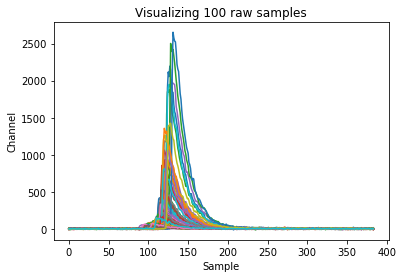

In [6]:
signal_raw = scint.load_signal_raw(r'../data/raw/andT_th000_ph065_20150212_155736_signal_raw.mat')
fig = scint_vis.plot_raw_pulses(signal_raw, np.arange(100))

# Calculate `L`

Calculate a few dimensions for convenience. 

In [7]:
[num_pulses, pulse_length] = signal_raw.shape
print(num_pulses)
print(pulse_length)

108800
384


## Simple method: Sum the entire pulse

The simplest way of calculating `L` is by summing the entire pulse. If the baseline subtraction is high quality, this should be just fine. Go for it. 

In [8]:
L_ch = np.sum(signal_raw,axis=1)

## More complex: Sum a range based on `i_p`

Sum a region relative to the rise time sample on the pulse, `i_p`. 

In [9]:
# How many samples back from i_p to start
Delta_0 = 10
# How many samples after i_p to end
Delta_2 = 100

In [10]:
# Calculate i_p
i_p = scint_math.cfd(signal_raw, frac = 0.5)

In [11]:
# Calculate boundary samples, correct any out of range
i_0 = i_p - Delta_0
i_0[i_0 < 0] = 0
i_2 = i_p + Delta_2
i_2[i_2 > pulse_length] = pulse_length

In [12]:
# Iterate through pulses and calculate L
L_ch = np.zeros(num_pulses)
for i in np.arange(num_pulses):
    L_ch[i] = scint_math.sum_pulse_region(signal_raw[i,:],i_0[i],i_2[i])

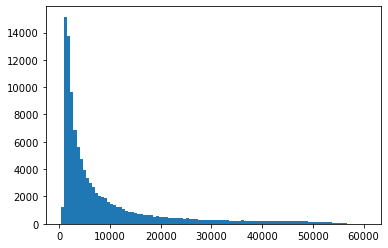

In [13]:
plt.hist(L_ch,100);

## Functionalize this as `calc_L_ch`

In [14]:
print(inspect.getsource(scint.calc_L_ch))

def calc_L_ch(signal_tot, Delta_0 = 10, Delta_2 = 100, cfd_frac = None):
    """
    Calculate the light output in integrated digitizer channel units, L_ch, from the baseline-subtracted signal, signal_tot.
    If no sample parameters are provided, simply sum the entire pulse. Otherwise, provide:
        - Delta_0, Delta_2, window boundaries relative to i_p
    
    Parameters
    ----------
    signal_tot : ndarray
        2-dimensional array of signal_tot (baseline-subtracted)
    Delta_0 : int, optional
        Window between i_p and starting sample
    Delta_2 : int, optional
        Window between i_p and ending sample
    cfd_frac : float, optional
        Fraction for cfd calculation to locate rise time of pulse
        If provided, calculate sum between [i_p-Delta_0:i_p+Delta_2] range
    
    Returns
    -------
    L_ch : ndarray
        Light output values in integrated digitizer channel units   
    """    
    # Note: These if statements are pretty sloppy. Should improve th

In [15]:
L_ch = scint.calc_L_ch(signal_raw)

In [16]:
L_ch = scint.calc_L_ch(signal_raw,
                       cfd_frac = 0.5)

In [17]:
L_ch = scint.calc_L_ch(signal_raw,
                       Delta_0 = 10,
                       Delta_2 = 350,
                       cfd_frac = 0.5)

# Calculate pulse shape `S`

I am using the tail-to-total method, as explained in Eqn. 2 in [this paper](https://ieeexplore.ieee.org/document/8353858/). 

## Implement the calculation

In [18]:
# How many samples back from i_p to start total region
Delta_0 = 10
# How many samples after i_p to start tail region
Delta_1 = 5
# How many samples after i_p to end tail and total regions
Delta_2 = 100

In [19]:
[num_pulses, pulse_length] = signal_raw.shape

In [20]:
# Set up integration regions
i_p = scint_math.cfd(signal_raw, frac = 0.5)

In [21]:
# Calculate boundary samples, correct any out of range
i_0 = i_p - Delta_0
i_0[i_0 < 0] = 0
i_1 = i_p + Delta_1
i_1[i_1 > pulse_length - 1] = pulse_length - 1
i_2 = i_p + Delta_2
i_2[i_2 > pulse_length - 1] = pulse_length - 1

In [22]:
# Iterate through pulses and calculate L
S = np.zeros(num_pulses)
for i in np.arange(num_pulses):        
    total = scint_math.sum_pulse_region(
                  signal_raw[i,:], i_0[i], i_2[i])
    tail = scint_math.sum_pulse_region(
                  signal_raw[i,:], i_1[i], i_2[i])
    S[i] = np.divide(tail,total)

## Functionalize as `Calc_S`

In [23]:
print(inspect.getsource(scint.calc_S))

def calc_S(signal_tot, 
           Delta_1, 
           Delta_2, 
           Delta_0 = 10, 
           cfd_frac = 0.5):
    """
    Calculate the pulse shape from the baseline-subtracted signal, signal_tot.
    
    Parameters
    ----------
    signal_tot : ndarray
        2-dimensional array of signal_tot (baseline-subtracted)
    Delta_1 : int
        Window between i_p and start sample of tail region
    Delta_2 : int
        Window between i_p and ending sample of tail and total regions
    Delta_0 : int, optional
        Window between i_p and starting sample
    cfd_frac : float, optional
        Fraction for cfd calculation to locate rise time of pulse
    
    Returns
    -------
    S : ndarray
        Pulse shape parameter, using the tail-to-total method  
    """    
    [num_pulses, pulse_length] = signal_tot.shape
    
    # Set up integration regions
    i_p = scint_math.cfd(signal_tot, cfd_frac)
    
    # Calculate boundary samples, correct any out of range
    i_0 = i

In [24]:
S = scint.calc_S(signal_raw, 60, 160)

In [25]:
S = scint.calc_S(signal_raw, 60, 160, 20, 0.6)

## Visualize `L` vs `S` in a 2D histogram

In [26]:
indices = scint_math.find_in_range(L_ch, 0, 60000, S, 0, 0.1)

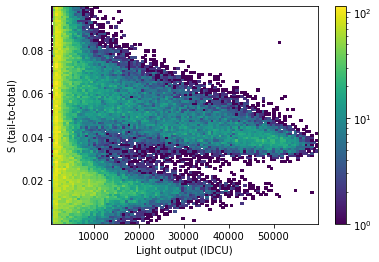

In [30]:
fig = plt.figure()
plt.hist2d(L_ch[indices],S[indices],bins=100,norm=matplotlib.colors.LogNorm())
plt.colorbar()
plt.xlabel('Light output (IDCU)')
plt.ylabel('S (tail-to-total)')
plt.show()

In [28]:
colorscale = scint_vis.create_log_colorscale()

In [29]:
# https://plotly.github.io/plotly.py-docs/generated/plotly.graph_objects.Histogram2d.html
trace = go.Histogram2d(x = L_ch[indices],
                       y = S[indices],
                       nbinsx = 100,
                       nbinsy = 100,
                       colorscale = colorscale)

layout = go.Layout(title = 'PSD Plot',
                   xaxis_title = 'L_ch',
                   yaxis_title = 'S')

fig = go.Figure(data = trace,
                layout = layout)

fig.show()

Functionalize these plots. 

In [32]:
print(inspect.getsource(scint_vis.plot_L_ch_vs_S))

def plot_L_ch_vs_S(L_ch, S, nbins = 100, plot_with = 'matpotlib'):
    """
    Create two-dimensional heatmap of L vs. S, also called a "PSD Plot"
    
    Parameters
    ----------
    L_ch : ndarray
        Light output values in integrated digitizer channel units
        As calculated by scint.calc_L_ch
    S : ndarray
        Pulse shape parameter, using the tail-to-total method  
        As calculated by scint.calc_S    
    nbins : int, optional
        Number of bins on each axis
    plot_with : string, optional
        'matplotlib' (default) or 'plotly'
    
    Returns
    -------
    fig : figure
        Either matplotlib or plotly figure
    """
    
    if plot_with == 'matplotlib':
        fig = plt.figure()
        plt.hist2d(L_ch,S,bins=nbins,norm=matplotlib.colors.LogNorm())
        plt.colorbar()
        plt.xlabel('Light output (IDCU)')
        plt.ylabel('S (tail-to-total)')

    if plot_with == 'plotly':
        # Set up colorscale
        colorscale = create_log_co

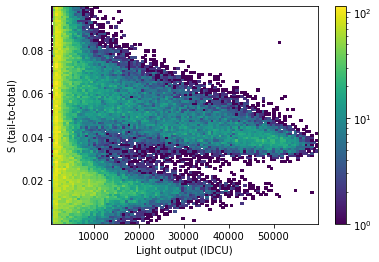

In [36]:
scint_vis.plot_L_ch_vs_S(L_ch[indices],
                         S[indices],
                         nbins = 100);

In [43]:
fig = scint_vis.plot_L_ch_vs_S(L_ch[indices],
                         S[indices],
                         nbins = 100,
                         plot_with = 'plotly');
fig.show()